In [6]:
import pandas as pd
import numpy as np
import nltk
from nltk.corpus import stopwords
from textblob import TextBlob
import string
import matplotlib.pyplot as plt
import seaborn as sns
from plotly import tools
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode, plot, iplot
from geopy.geocoders import Nominatim
import folium
from folium.plugins import HeatMap
from folium.plugins import FastMarkerCluster
import re
from warnings import filterwarnings
filterwarnings('ignore')
from mpl_toolkits.mplot3d import Axes3D
from sklearn.ensemble import IsolationForest
from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch
from sklearn.cluster import OPTICS


In [7]:
# Downloaded stopwords dataset
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ASUS\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

# Data Understanding

In [8]:
#from google.colab import drive
#drive.mount('/content/drive')

#path="/content/drive/My Drive/zomato.csv"

path="zomato.csv"

df = pd.read_csv(path)
df.tail(50)

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
51667,https://www.zomato.com/bangalore/w-xyz-aloft-h...,"Aloft Hotel, 17C, Sadaramangala Road, Whitefie...",W XYZ - Aloft Hotel,No,Yes,3.7 /5,95,+91 7338460103\n+91 9591386430,Whitefield,Lounge,Tikka,Finger Food,"1,700","[('Rated 4.0', 'RATED\n Good collection of sp...",[],Drinks & nightlife,Whitefield
51668,https://www.zomato.com/bangalore/izakaya-gastr...,"2nd Floor, Iona, Virginia Mall, Whitefield Mai...",Izakaya Gastro Pub,Yes,Yes,3.8 /5,128,+91 7625087121\n+91 8050587483,Whitefield,"Bar, Casual Dining","Beer, Chicken Guntur, Paneer Tikka, Fish, Nood...","North Indian, Continental, Mediterranean","1,200","[('Rated 3.0', ""RATED\n Nice place to hangout...",[],Drinks & nightlife,Whitefield
51669,https://www.zomato.com/bangalore/red-glow-whit...,"Poornima Complex, Dodsworth Layout, Whitefield...",Red Glow,No,No,3.7 /5,27,+91 9740571131,Whitefield,Pub,NaN,"North Indian, Continental","1,200","[('Rated 5.0', 'RATED\n Excellent place had n...",[],Drinks & nightlife,Whitefield
51670,https://www.zomato.com/bangalore/miro-bar-mira...,"Miraya Hotel & Residences, 100/6, Varthur Main...",Miro Bar - Miraya Hotel & Residences,No,No,3.8 /5,26,+91 7760961733\n+91 7760961714,Whitefield,Lounge,NaN,"North Indian, Chinese, Thai, Asian","2,000","[('Rated 5.0', ""RATED\n Miro as the name sugg...",[],Drinks & nightlife,Whitefield
51671,https://www.zomato.com/bangalore/m-bar-bengalu...,"Bengaluru Marriott Hotel, 75, 8th Road, EPIP A...",M Bar - Bengaluru Marriott Hotel Whitefield,No,No,3.9 /5,77,080 49435000,Whitefield,"Fine Dining, Bar",Rooftop Ambience,Finger Food,"2,000","[('Rated 4.0', 'RATED\n Went there post dinne...",[],Drinks & nightlife,Whitefield
51672,https://www.zomato.com/bangalore/slounge-lemon...,"Lemon Tree Hotel, 23, EPIP Zone, Near I Gate C...",Slounge - Lemon Tree Hotel,No,Yes,3.9 /5,21,080 43311555\n+91 9900047825,Whitefield,Lounge,NaN,Finger Food,"1,500",[],[],Drinks & nightlife,Whitefield
51673,https://www.zomato.com/bangalore/checkered-bar...,"MGM Mark Whitefield, 23, EPIP Zone, Whitefield...",Checkered Bar - MGM Mark,No,No,3.6 /5,19,+91 9164752268\n080 41985556,Whitefield,Lounge,NaN,"North Indian, Continental, Chinese","1,300","[('Rated 4.0', 'RATED\n Staying at the MGM Wh...",[],Drinks & nightlife,Whitefield
51674,https://www.zomato.com/bangalore/the-farm-hous...,"136, SAP Labs India, KIADB Export Promotion In...",The Farm House Bar n Grill,No,No,3.7 /5,34,+91 9980121279\n+91 9900240646,Whitefield,"Casual Dining, Bar",NaN,"North Indian, Continental",800,"[('Rated 4.0', 'RATED\n Ambience- Big and spa...",[],Drinks & nightlife,Whitefield
51675,https://www.zomato.com/bangalore/topsy-turvey-...,"2E2, 4th Cross Road, Devasandra Industrial Est...",Topsy Turvey,No,No,NaN,0,+91 9148155994,Whitefield,Bar,NaN,Finger Food,900,"[('Rated 4.0', ""RATED\n A divine joint for Fl...",[],Drinks & nightlife,Whitefield
51676,https://www.zomato.com/bangalore/tease-whitefi...,"Vivanta Whitefield, ITPB, Whitefield, Bangalore",Tease Whitefield,No,Yes,3.7 /5,64,+91 9606098174\n080 67343085,Whitefield,Lounge,Pizza,Finger Food,"1,800","[('Rated 4.0', 'RATED\n We have been here for...",[],Drinks & nightlife,Whitefield


Check the number of rows and column of the data set

In [9]:
rows, cols = df.shape
print("Number of rows:", rows)
print("Number of columns:", cols)

Number of rows: 51717
Number of columns: 17


Information on features

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51717 entries, 0 to 51716
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   url                          51717 non-null  object
 1   address                      51717 non-null  object
 2   name                         51717 non-null  object
 3   online_order                 51717 non-null  object
 4   book_table                   51717 non-null  object
 5   rate                         43942 non-null  object
 6   votes                        51717 non-null  int64 
 7   phone                        50509 non-null  object
 8   location                     51696 non-null  object
 9   rest_type                    51490 non-null  object
 10  dish_liked                   23639 non-null  object
 11  cuisines                     51672 non-null  object
 12  approx_cost(for two people)  51371 non-null  object
 13  reviews_list                 51

In [11]:
df.describe()

,votes
count,51717.000000
mean,283.697527
std,803.838853
min,0.000000
25%,7.000000
50%,41.000000
75%,198.000000
max,16832.000000


## Data Preprocessing

# Duplicated data

In [12]:
df.duplicated().sum()

0

Check the sum of null data in each column

In [13]:
df.isnull().sum()

url                                0
address                            0
name                               0
online_order                       0
book_table                         0
rate                            7775
votes                              0
phone                           1208
location                          21
rest_type                        227
dish_liked                     28078
cuisines                          45
approx_cost(for two people)      346
reviews_list                       0
menu_item                          0
listed_in(type)                    0
listed_in(city)                    0
dtype: int64

*   Handle 'rate' -> check skewness
*   Drop phone number, url, name, review(consider later), menu_item (too many missing value)
*   dish_liked(to many missing value)
*   location&listed_in(city) is the same -> choose one
*   rest_type -> used mode to fill
*   dish_liked -> remove
*   cuisines put-> use mode
*   approx_cost(for two people) --> check skewness to decide

Rename the columns

In [14]:
df.rename(columns={'approx_cost(for two people)': 'average_cost', 'listed_in(city)': 'locality',}, inplace=True)

# Inconsistent Data

In [15]:
(df['votes'] < 0).sum()

0

# Invalid Data

Replace the '[]' with null in columns

In [16]:
df['menu_item'] = df['menu_item'].apply(lambda x: np.nan if x == '[]' else x)

df['reviews_list'] = df['reviews_list'].apply(lambda x: np.nan if x == '[]' else x)

Define a function change 'yes' & 'no' -> 0,1

In [17]:
def clean_binary_columns(value):
    if value == 'Yes':
        return 1
    elif value == 'No':
        return 0
    else:
        return pd.NaT

Clean 'online_order' and 'book_table' columns using the function

In [18]:
df['online_order'] = df['online_order'].apply(clean_binary_columns)
df['book_table'] = df['book_table'].apply(clean_binary_columns)

# Data Type Issue

Remove '/5' from 'rate' and convert to numeric

In [19]:
df['rate'] = df['rate'].str.replace('/5', '')
df['rate'] = pd.to_numeric(df['rate'], errors='coerce')

Remove commas from 'approx_cost(for two people)' and convert to float

In [20]:
df['average_cost'] = df['average_cost'].str.replace(',', '')
df['average_cost'] = pd.to_numeric(df['average_cost'], errors='coerce')

# Filling Missing Value

Check the skewness before filling the null value

In [21]:
df['rate'].skew()

-0.32860079817829163

In [22]:
df['average_cost'].skew()

2.6019834564289535

The skew value show slightly left-skewed (negatively skewed) distribution, hence filling up the missing value with MEDIAN

In [23]:
df['rate'] = df['rate'].fillna(df['rate'].median())

Using MEDIAN to fill in missing values for Highly right-skewed (positively skewed) distribution

In [24]:
df['average_cost'] = df['average_cost'].fillna(df['average_cost'].median())

Dropping rows where 'rest_type' or 'cuisines' is null

In [25]:
df.dropna(subset=['rest_type', 'cuisines'], inplace=True)

# Contaminated Data

In [26]:
# Assuming you have a DataFrame named 'df' with the columns mentioned
# Check for 'error' or 'N/A' in each column
error_na_columns = []
for column in df.columns:
    if df[column].astype(str).str.contains('N/A|Error', case=False).any():
        error_na_columns.append(column)

# Print the columns that contain 'error' or 'N/A'
print("Columns containing 'error' or 'N/A':", error_na_columns)

Columns containing 'error' or 'N/A': ['reviews_list', 'menu_item']


- Due to the contaminated data and not useful for this column, we decide to drop the 'menu column'.

## Handle review column

In [27]:
df.dropna(subset=['reviews_list'], inplace=True)

In [28]:
df.rename(columns={'reviews_list': 'review_sentiment'}, inplace=True)

In [29]:
stop_words = set(stopwords.words('english'))

def clean_text(text):
    # Remove non-alphanumeric characters
    text = ''.join([char for char in text if char not in string.punctuation])
    # Convert text to lowercase
    text = text.lower()
    # Remove stopwords
    text = ' '.join([word for word in text.split() if word not in stop_words])
    return text

def analyze_sentiment(review):
    review = clean_text(review)  # Clean the text
    testimonial = TextBlob(review)
    polarity = testimonial.sentiment.polarity
    return "Positive" if polarity > 0 else "Negative" if polarity < 0 else "Neutral"

# Apply the analyze_sentiment function on the df
df['review_sentiment'] = df['review_sentiment'].apply(analyze_sentiment)


In [30]:
# Count how many times each unique review appears in the 'reviews_list' column
review_counts = df['review_sentiment'].value_counts()

print(review_counts)


Positive    39749
Negative     3997
Neutral       204
Name: review_sentiment, dtype: int64


# Structural Errors
Sructural errors refer to issues related to the organization or structure of the data rather than the content or values within it. Dropping an unused column can improve the structure of the dataset by removing unnecessary elements, making it more efficient and easier to work with.

Drop unuse columns

In [31]:
df.drop('url', axis=1, inplace=True)
df.drop('phone', axis=1, inplace=True)
df.drop('address', axis=1, inplace=True)
df.drop('name', axis=1, inplace=True)
df.drop('location', axis=1, inplace=True)
df.drop('dish_liked', axis=1, inplace=True)
df.drop('menu_item',axis=1,inplace=True)

Check the sum of null data in each column

In [32]:
df.isnull().sum()

online_order        0
book_table          0
rate                0
votes               0
rest_type           0
cuisines            0
average_cost        0
review_sentiment    0
listed_in(type)     0
locality            0
dtype: int64

In [33]:
df.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 43950 entries, 0 to 51716
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   online_order      43950 non-null  int64  
 1   book_table        43950 non-null  int64  
 2   rate              43950 non-null  float64
 3   votes             43950 non-null  int64  
 4   rest_type         43950 non-null  object 
 5   cuisines          43950 non-null  object 
 6   average_cost      43950 non-null  float64
 7   review_sentiment  43950 non-null  object 
 8   listed_in(type)   43950 non-null  object 
 9   locality          43950 non-null  object 
dtypes: float64(2), int64(3), object(5)
memory usage: 3.7+ MB


## Exploratory Data Analysis

Distribution of Ratings Across Various Dining Type

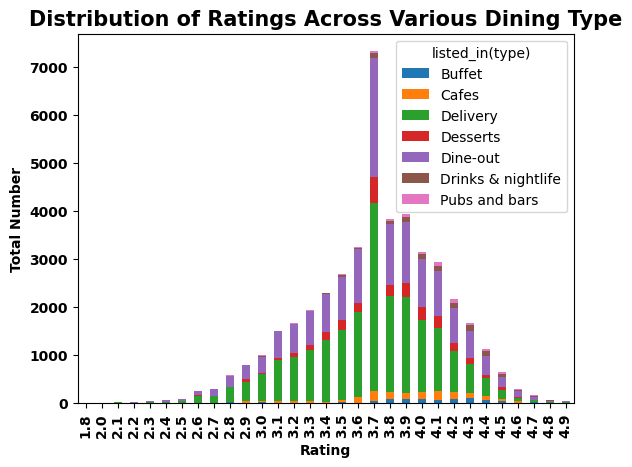

In [34]:
type_plt=pd.crosstab(df['rate'],df['listed_in(type)'])
type_plt.plot(kind='bar',stacked=True);
plt.title('Distribution of Ratings Across Various Dining Type',fontsize=15,fontweight='bold')
plt.ylabel('Total Number',fontsize=10,fontweight='bold')
plt.xlabel('Rating',fontsize=10,fontweight='bold')
plt.xticks(fontsize=10,fontweight='bold')
plt.yticks(fontsize=10,fontweight='bold');


*   The x-axis represents ratings on a scale from 1 to 5 (with increments of 0.1), while the y-axis shows different dining categories and the total number of each rating.
*   The 3.7 rating is the most higher rating that rate by the customer is about 14000 in total number





Distribution of Ratings Across Different Restaurant Types

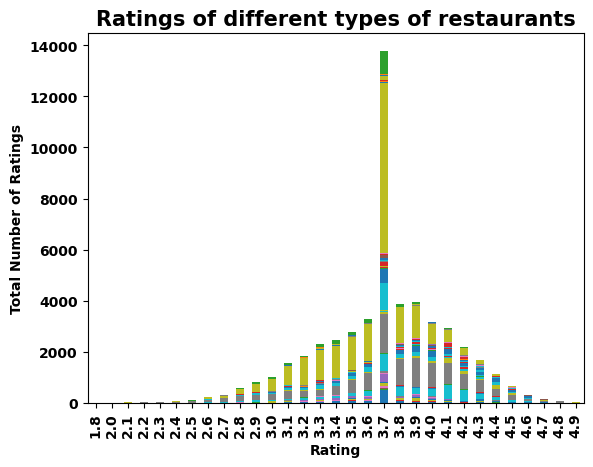

In [ ]:
loc_plt=pd.crosstab(df['rate'],df['rest_type'])
loc_plt.plot(kind='bar',stacked=True);
plt.title('Ratings of different types of restaurants',fontsize=15,fontweight='bold')
plt.ylabel('Total Number of Ratings',fontsize=10,fontweight='bold')
plt.xlabel('Rating',fontsize=10,fontweight='bold')
plt.xticks(fontsize=10,fontweight='bold')
plt.yticks(fontsize=10,fontweight='bold')
plt.legend().remove();

*   The x-axis represents ratings on a scale from 1 to 5 (with increments of 0.1), while the y-axis shows different restaurant type and the total number of each rating.
*   The 3.7 rating is the most higher rating that rate by the customer is about 14000 in total number





Distribution of Top 4 Locations in Food Listings

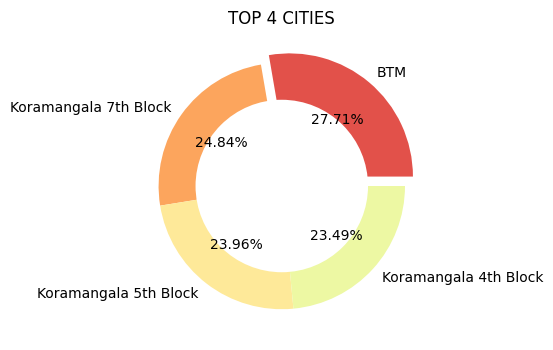

In [ ]:
cities=df["locality"].value_counts().index[:4]
orders=df["locality"].value_counts().values[:4]
centre_circle = plt.Circle((0,0),0.70,fc='white')
plt.figure(figsize=(6,4))
plt.pie(orders,labels=cities,
        autopct="%1.2f%%",
        explode=[0.1,0,0,0],
        colors=sns.color_palette("Spectral"))
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.title("TOP 4 CITIES")
plt.show()



*   There are the top 4 cities in the distribution of rating which is BTM, Koramangala 4th Block,Koramangala 5th Block and Koramangala 7th Block.
*   BTM have the highest percentage is aboout 27.71% while Koramangala 4th Block have the lowest percentage which is 23.49%.



Comparison of Ratings for Restaurants With and Without Table Booking

<Figure size 700x700 with 0 Axes>

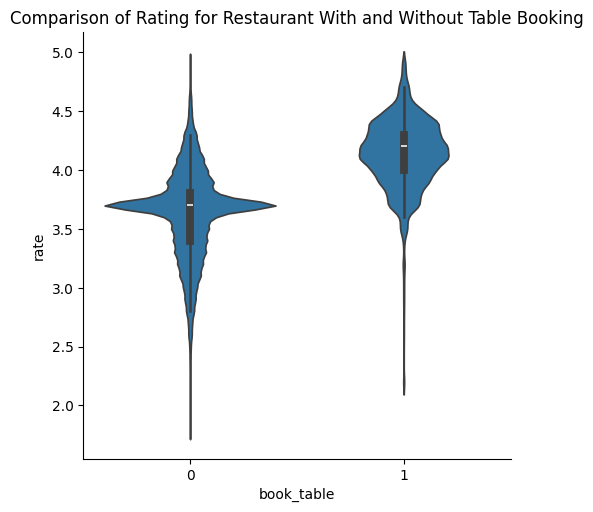

In [ ]:
plt.figure(figsize=(7, 7))
sns.catplot(x="book_table", y="rate", kind="violin", data=df).set(title='Comparison of Rating for Restaurant With and Without Table Booking')
plt.show()



*   The median rating of have booking table is about 3.6 or 3.7 while the rating of without booking table is about 4.3 or 4.4.
*   There are some outlier of rating for table booking column.



Ratings and Votes by Top 10 Restaurant Type

In [ ]:
top_rest_types = df['rest_type'].value_counts().head(10).index
df_filtered = df[df['rest_type'].isin(top_rest_types)]

fig = px.scatter(df_filtered, x="rate", y="votes",
                 color="average_cost",
                 facet_col="rest_type", facet_col_wrap=2,
                 title="Ratings and Votes by Top 10 Restaurant Type")
fig.show()



*   There are the top 10 type of restaurant tha rate and vote by the customer such as Casual Dining or Bakery.
*   Based on the graph,the Casual Dining restaurant have the most highest votes is about 12.12k.



Restaurant Ratings, Popularity, and Cost Analysis

In [ ]:
 fig = px.scatter_3d(df, x='rate', y='votes', z='average_cost',
                    color='rate', symbol='book_table',
                    opacity=0.7, hover_data=['rest_type', 'cuisines'])
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

Density and Cost Distribution of Ratings

In [ ]:
fig = px.density_contour(df, x="rate", y="average_cost",
                         marginal_x="rug", marginal_y="histogram")
fig.show()

Bubble Chart of Rating on Cuisines

In [ ]:
fig = px.scatter(df, x="cuisines", y="rate",
                 size="votes", color="rate",
                 hover_name="cuisines", size_max=100)
fig.update_layout(xaxis={'categoryorder':'total descending'})
fig.show()

Sunburst Chart Restaurant Types, Cities, and Cuisines

In [ ]:
fig = px.sunburst(df, path=['listed_in(type)', 'locality', 'cuisines'],
                  color='rate', hover_data=['rate'],
                  color_continuous_scale='Plasma',
                  title="Sunburst Chart of Restaurant Types, Cities, and Cuisines")
fig.show()

Violin plot of votes on online order

<Figure size 700x700 with 0 Axes>

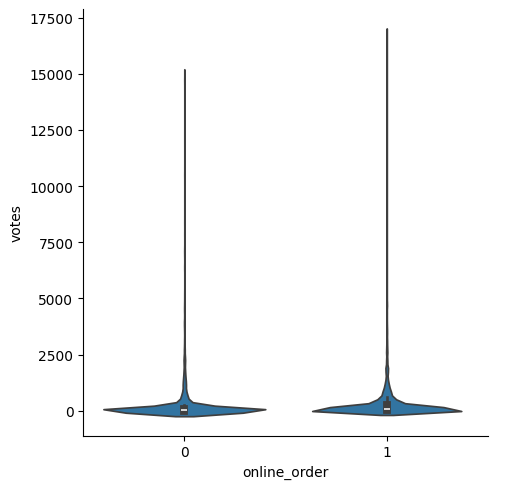

In [ ]:
plt.figure(figsize=(7, 7))
sns.catplot(x="online_order", y="votes", kind="violin", data=df)
plt.show()

Get the top 10 most frequent 'rest_type' categories & Filter the DataFrame to only include the top 10 categories

In [ ]:
top_10_rest_types = df['rest_type'].value_counts().nlargest(10).index

filtered_df = df[df['rest_type'].isin(top_10_rest_types)]

Violin plot of Top 10 Restaurant Types

<Figure size 1000x800 with 0 Axes>

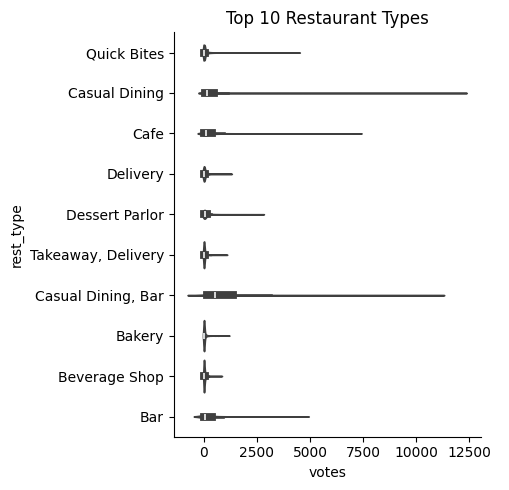

In [ ]:
plt.figure(figsize=(10, 8))
sns.catplot(x="votes", y="rest_type", kind="violin", data=filtered_df, order=top_10_rest_types)
plt.title("Top 10 Restaurant Types")
plt.tight_layout()
plt.show()

Calculate the total number of unique number for the 'locality' column

In [96]:
len(df['locality'].unique())

30

Check the name of the 'locality' column

In [97]:
locations=pd.DataFrame({"Name":df['locality'].unique()})
locations.head()

,Name
0,Banashankari
1,Bannerghatta Road
2,Basavanagudi
3,Bellandur
4,Brigade Road


Generate the Latitute and Longitude for the 'locality' column

In [98]:
    geolocator=Nominatim(user_agent="app")

    lat=[]
    lon=[]
    for location in locations['Name']:
        location = geolocator.geocode(location,timeout=10)
        if location is None:
            lat.append(np.nan)
            lon.append(np.nan)
        else:
            lat.append(location.latitude)
            lon.append(location.longitude)

    locations['lat']=lat
    locations['lon']=lon

    locations.head()

,Name,lat,lon
0,Banashankari,15.887678,75.704678
1,Bannerghatta Road,12.936629,77.601471
2,Basavanagudi,13.834591,75.733936
3,Bellandur,12.931032,77.678247
4,Brigade Road,-32.145131,115.971492


Calculate the total number of the each value in the 'locality' column

In [99]:
Rest_locations=pd.DataFrame(df['locality'].value_counts().reset_index())

Rest_locations.columns=['Name','count']
Rest_locations.head()

,Name,count
0,BTM,3265
1,Koramangala 7th Block,2927
2,Koramangala 5th Block,2823
3,Koramangala 4th Block,2768
4,Koramangala 6th Block,2614


Check the size of the variable

In [100]:
print(locations.shape)
print(Rest_locations.shape)

(30, 3)
(30, 2)


Combine the name,total number,latitude and longitude in a variable

In [101]:
Restaurant_locations=Rest_locations.merge(locations,on='Name',how="left").dropna()
Restaurant_locations.head()

,Name,count,lat,lon
0,BTM,3265,45.954851,-112.496595
1,Koramangala 7th Block,2927,12.936485,77.613478
2,Koramangala 5th Block,2823,12.934843,77.618977
3,Koramangala 4th Block,2768,12.932778,77.629405
4,Koramangala 6th Block,2614,12.939025,77.623848


Calculate the maximum number of the total number in the variable

In [102]:
Restaurant_locations['count'].max()

3265

Define a function call generatesBaseMap to generate the base map

In [103]:
#### Bengaluru Coordinates - (12.9716° N, 77.5946° E)
def generateBaseMap(default_location=[12.97, 77.59], default_zoom_start=12):
    base_map = folium.Map(location=default_location, zoom_start=default_zoom_start)
    return base_map

Generate a basic base map

In [104]:
basemap=generateBaseMap()
basemap

Print all of the value in the variable

In [105]:
Restaurant_locations[['lat','lon','count']]

,lat,lon,count
0,45.954851,-112.496595,3265
1,12.936485,77.613478,2927
2,12.934843,77.618977,2823
3,12.932778,77.629405,2768
4,12.939025,77.623848,2614
5,27.349301,95.315941,2366
6,12.909694,77.586607,2079
7,12.973291,77.640467,1851
8,40.714989,-74.007884,1826
9,12.975526,77.606790,1807


Add the heapmap of the variable into the basemap

In [106]:
HeatMap(Restaurant_locations[['lat','lon','count']],zoom=20,radius=15).add_to(basemap)

Generate the basemap after add in the heapmap

In [107]:
basemap

List out the total number of restaurant in the basemap

In [108]:
FastMarkerCluster(data=Restaurant_locations[['lat','lon','count']].values.tolist()).add_to(basemap)

basemap

## Remove Outliers

Adjust the isolation forest and LOF to consider 'votes' as well

In [35]:
iso = IsolationForest(contamination=0.05)
iso_fit = iso.fit_predict(df[['rate', 'average_cost', 'votes']])

lof = LocalOutlierFactor(n_neighbors=20, novelty=True, contamination=0.05)
lof.fit(df[['rate', 'average_cost', 'votes']])
lof_fit = lof.predict(df[['rate', 'average_cost', 'votes']])


Update outlier markers in the dataframe

In [36]:
df['iso_outlier'] = iso_fit == -1
df['lof_outlier'] = lof_fit == -1

'iso_outlier' and 'lof_outlier' are columns in df that mark outliers as True or False, create a new column to mark the common outliers

In [37]:
df['both_outlier'] = df['iso_outlier'] & df['lof_outlier']

1. Create the plotly figure
2. Add traces
  *   Normal Points
  *   Isolation Forest Outliers
  *   LOF Outliers
  *   Common Outliers
3. Plot the graph

In [38]:
fig = go.Figure()

# Normal points
fig.add_trace(go.Scatter3d(
    x=df[~df['iso_outlier'] & ~df['lof_outlier']]['rate'],
    y=df[~df['iso_outlier'] & ~df['lof_outlier']]['average_cost'],
    z=df[~df['iso_outlier'] & ~df['lof_outlier']]['votes'],
    mode='markers',
    name='Normal',
    marker=dict(color='yellow', size=3)
))

# Isolation Forest outliers
fig.add_trace(go.Scatter3d(
    x=df[df['iso_outlier'] & ~df['both_outlier']]['rate'],
    y=df[df['iso_outlier'] & ~df['both_outlier']]['average_cost'],
    z=df[df['iso_outlier'] & ~df['both_outlier']]['votes'],
    mode='markers',
    name='Isolation Forest Outliers',
    marker=dict(color='red', size=5)
))

# LOF outliers
fig.add_trace(go.Scatter3d(
    x=df[df['lof_outlier'] & ~df['both_outlier']]['rate'],
    y=df[df['lof_outlier'] & ~df['both_outlier']]['average_cost'],
    z=df[df['lof_outlier'] & ~df['both_outlier']]['votes'],
    mode='markers',
    name='LOF Outliers',
    marker=dict(color='blue', size=5)
))

# Common outliers detected by both methods
fig.add_trace(go.Scatter3d(
    x=df[df['both_outlier']]['rate'],
    y=df[df['both_outlier']]['average_cost'],
    z=df[df['both_outlier']]['votes'],
    mode='markers',
    name='Both Outliers',
    marker=dict(color='purple', size=6)
))

# Update the layout for the plot
fig.update_layout(
    margin=dict(l=0, r=0, b=0, t=0),
    scene=dict(
        xaxis_title='Rate',
        yaxis_title='Average Cost',
        zaxis_title='Votes'
    ),
    title='3D Scatter Plot of Outliers'
)

fig.show()

Define the removal condition based on the specified criteria

In [39]:
removal_condition = (df['votes'] >= 6876) | (df['rate'] <= 2.4) | (df['average_cost'] >= 4500)

Apply the condition to the DataFrame to remove the outliers

In [40]:
df = df[~removal_condition]

Define a function to clean 'location', 'rest_type', 'cuisines', and 'listed_in(type)' columns

In [41]:
def clean_categorical_columns(value, common_values):
    if pd.isnull(value):
        return pd.NaT
    elif value in common_values:
        return value
    else:
        return 'Other'

Keep top 10 most common locations, restaurant types, cuisines, and types

In [42]:
top_locality = df['locality'].value_counts()[:10].index.tolist()
top_rest_types = df['rest_type'].value_counts()[:10].index.tolist()
top_cuisines = df['cuisines'].value_counts()[:10].index.tolist()
top_types = df['listed_in(type)'].value_counts()[:10].index.tolist()


Clean 'location', 'rest_type', 'cuisines', and 'listed_in(type)' columns

In [43]:
df['locality'] = df['locality'].apply(clean_categorical_columns, common_values=top_locality)
df['rest_type'] = df['rest_type'].apply(clean_categorical_columns, common_values=top_rest_types)
df['cuisines'] = df['cuisines'].apply(clean_categorical_columns, common_values=top_cuisines)
df['listed_in(type)'] = df['listed_in(type)'].apply(clean_categorical_columns, common_values=top_types)

Display a summary of the dataset

In [44]:
display(df.describe(include='all'))

,online_order,book_table,rate,votes,rest_type,cuisines,average_cost,review_sentiment,listed_in(type),locality,iso_outlier,lof_outlier,both_outlier
count,43603.000000,43603.000000,43603.000000,43603.000000,43603,43603,43603.000000,43603,43603,43603,43603,43603,43603
unique,NaN,NaN,NaN,NaN,11,11,NaN,3,7,11,2,2,2
top,NaN,NaN,NaN,NaN,Quick Bites,Other,NaN,Positive,Delivery,Other,False,False,False
freq,NaN,NaN,NaN,NaN,15084,33688,NaN,39502,21842,22773,41649,41583,43548
mean,0.646378,0.143408,3.712242,299.629177,NaN,NaN,585.145884,NaN,NaN,NaN,NaN,NaN,NaN
std,0.478099,0.350492,0.410205,658.174457,NaN,NaN,450.590575,NaN,NaN,NaN,NaN,NaN,NaN
min,0.000000,0.000000,2.500000,0.000000,NaN,NaN,40.000000,NaN,NaN,NaN,NaN,NaN,NaN
25%,0.000000,0.000000,3.500000,16.000000,NaN,NaN,300.000000,NaN,NaN,NaN,NaN,NaN,NaN
50%,1.000000,0.000000,3.700000,61.000000,NaN,NaN,450.000000,NaN,NaN,NaN,NaN,NaN,NaN
75%,1.000000,0.000000,4.000000,244.000000,NaN,NaN,700.000000,NaN,NaN,NaN,NaN,NaN,NaN


Display unique values in the categorical columns


In [45]:
for col in ['locality', 'rest_type', 'cuisines', 'listed_in(type)']:
    print(f'{col}:\n{df[col].unique()}\n')

locality:
['Other' 'BTM' 'Church Street' 'Indiranagar' 'Jayanagar' 'JP Nagar'
 'Koramangala 4th Block' 'Koramangala 5th Block' 'Koramangala 6th Block'
 'Koramangala 7th Block' 'MG Road']

rest_type:
['Casual Dining' 'Other' 'Quick Bites' 'Cafe' 'Delivery' 'Dessert Parlor'
 'Bakery' 'Takeaway, Delivery' 'Beverage Shop' 'Bar' 'Casual Dining, Bar']

cuisines:
['Other' 'North Indian' 'Cafe' 'Bakery, Desserts' 'Biryani' 'South Indian'
 'North Indian, Chinese' 'Bakery' 'Fast Food' 'Desserts'
 'South Indian, North Indian, Chinese']

listed_in(type):
['Buffet' 'Cafes' 'Delivery' 'Desserts' 'Dine-out' 'Drinks & nightlife'
 'Pubs and bars']



Consider a restaurant as expensive if the cost for two people is higher than the median
> Reducing a continuous variable to simplifies the model



In [46]:
median_cost = df['average_cost'].median()
df['expensive'] = df['average_cost'].apply(lambda x: 1 if x > median_cost else 0)

Drop the original 'average_cost' column

In [47]:
df = df.drop(columns='average_cost')

Check again for all the column

In [48]:
df.head()

,online_order,book_table,rate,votes,rest_type,cuisines,review_sentiment,listed_in(type),locality,iso_outlier,lof_outlier,both_outlier,expensive
0,1,1,4.1,775,Casual Dining,Other,Positive,Buffet,Other,False,False,False,1
1,1,0,4.1,787,Casual Dining,Other,Positive,Buffet,Other,False,False,False,1
2,1,0,3.8,918,Other,Other,Positive,Buffet,Other,False,False,False,1
3,0,0,3.7,88,Quick Bites,Other,Positive,Buffet,Other,False,False,False,0
4,0,0,3.8,166,Casual Dining,Other,Positive,Buffet,Other,False,False,False,1


Drop the 'iso_outlier' , 'lof_outlier' and 'both_outlier' column

In [49]:
df.drop('iso_outlier',axis=1,inplace=True)
df.drop('lof_outlier',axis=1,inplace=True)
df.drop('both_outlier',axis=1,inplace=True)

## Standardize and Encoding

1.   Define the categorical columns
2.   Initialize the OneHotEncoder
3.   Create a DataFrame with the encoded variables
4.   Initialize the StandardScaler
5.   Select only the numerical columns to standardize (excluding one-hot encoded columns)
6.   Apply the scaler to the numerical columns
7.   Concatenate the standardized numerical columns with the encoded categorical columns



In [50]:
categorical_columns = ['rest_type', 'cuisines', 'listed_in(type)', 'locality','review_sentiment']

encoder = OneHotEncoder(sparse_output=False)
encoded_categorical = encoder.fit_transform(df[categorical_columns])

encoded_categorical_df = pd.DataFrame(encoded_categorical, columns=encoder.get_feature_names_out())

scaler = StandardScaler()

numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()

df[numerical_cols] = scaler.fit_transform(df[numerical_cols])

final_df_for_clustering = pd.concat([df[numerical_cols].reset_index(drop=True),
                                     encoded_categorical_df.reset_index(drop=True)], axis=1)

Checking the column data type for clustering

In [51]:
final_df_for_clustering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43603 entries, 0 to 43602
Data columns (total 48 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   online_order                                  43603 non-null  float64
 1   book_table                                    43603 non-null  float64
 2   rate                                          43603 non-null  float64
 3   votes                                         43603 non-null  float64
 4   expensive                                     43603 non-null  float64
 5   rest_type_Bakery                              43603 non-null  float64
 6   rest_type_Bar                                 43603 non-null  float64
 7   rest_type_Beverage Shop                       43603 non-null  float64
 8   rest_type_Cafe                                43603 non-null  float64
 9   rest_type_Casual Dining                       43603 non-null 

## Clustering Algorithms

## 1. DBSCAN

*   Find an optimal value for eps using the NearestNeighbors
*   Sort distances
*   Compute the discrete difference (derivative) of the distances
*   Find the index of the maximum gradient

In [ ]:
# Find an optimal value for eps using the NearestNeighbors
neigh = NearestNeighbors(n_neighbors=2) #can change to see the performance
nbrs = neigh.fit(final_df_for_clustering)
distances, indices = nbrs.kneighbors(final_df_for_clustering)

# Sort distances
distances = np.sort(distances, axis=0)
distances = distances[:, 1]

# Compute the discrete difference(deriavative)of the distances
gradient = np.diff(distances)

# Find the index of the maximum gradient
optimal_index = np.argmax(gradient)
optimal_eps = distances[optimal_index + 1]

Gradient of K-Nearest Neighbors distances

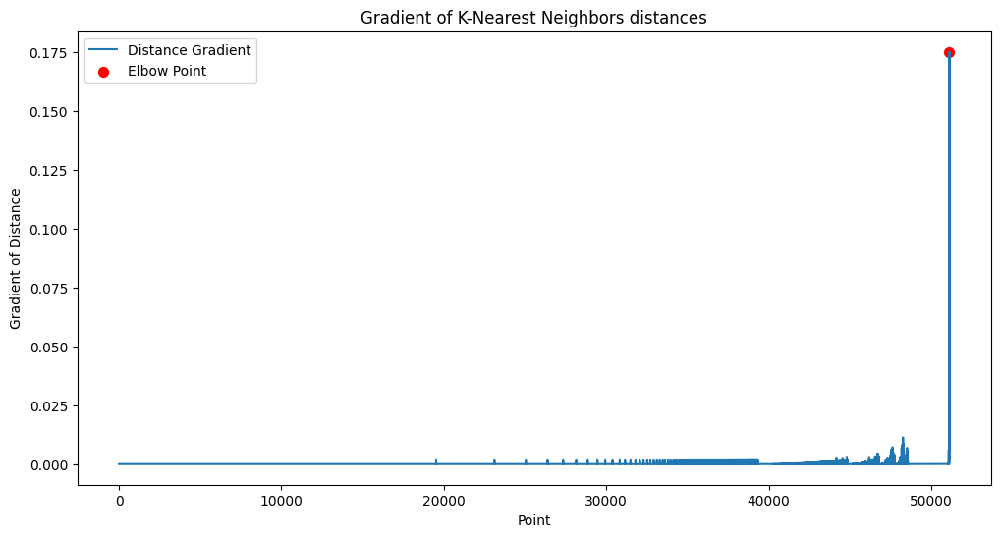

In [ ]:
# Plot the gradient and the point of maximum curvature (elbow)
plt.figure(figsize=(12, 6))
plt.plot(gradient, label='Distance Gradient')
plt.scatter(optimal_index, gradient[optimal_index], color='red', s=50, label='Elbow Point')
plt.title('Gradient of K-Nearest Neighbors distances')
plt.xlabel('Point')
plt.ylabel('Gradient of Distance')
plt.legend()
plt.show()


*   Perform DBSCAN clustering using the optimal_eps value determined
*   Create a copy of the dataframe with cluster labels for further analysis
*   Exclude noise points for silhouette score calculation
*   Calculate silhouette score (if applicable)
*   Perform t-SNE dimensionality reduction for visualization
*   Visualize the original and clustered data using t-SNE

In [ ]:
# Perform DBSCAN clustering using the optimal_eps value determined
dbscan = DBSCAN(eps=optimal_eps, min_samples=5)
clusters = dbscan.fit_predict(final_df_for_clustering)

# Create a copy of the dataframe with cluster labels for further analysis
dbscan_cluster_df = final_df_for_clustering.copy()
dbscan_cluster_df['clusters'] = clusters

# Exclude noise points for silhouette score calculation
noise = clusters == -1
valid_clusters = clusters[~noise]
valid_points = final_df_for_clustering[~noise]

# Calculate silhouette score (if applicable)
if len(np.unique(valid_clusters)) > 1:
    sil_score = silhouette_score(valid_points, valid_clusters)
    print('Silhouette Score (excluding noise): %.3f' % sil_score)
else:
    print('Silhouette score is not applicable due to the number of clusters.')

# Perform t-SNE dimensionality reduction for visualization
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42)
tsne_results = tsne.fit_transform(final_df_for_clustering)

Silhouette Score (excluding noise): 0.203


*   Visualize the original and clustered data using t-SNE
*   Original data (t-SNE)
*   Clustered data (t-SNE)
*   Creating a custom legend for noise and clusters
*   Plot DBSCAN Clustering (t-SNE) Graph

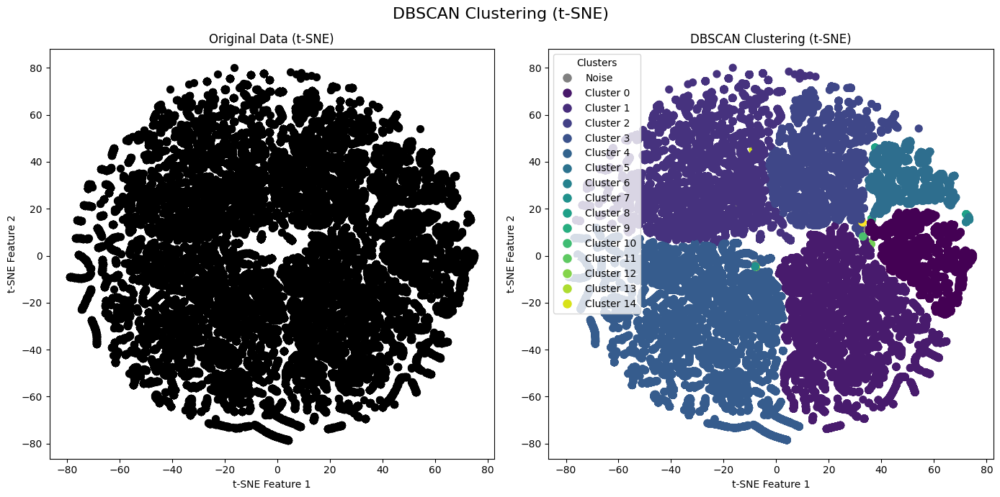

In [ ]:
# Visualize the original and clustered data using t-SNE
fig, axs = plt.subplots(1, 2, figsize=(14, 7))

# Original data (t-SNE)
axs[0].scatter(tsne_results[:, 0], tsne_results[:, 1], c='black', s=50)
axs[0].set_title('Original Data (t-SNE)')
axs[0].set_xlabel('t-SNE Feature 1')
axs[0].set_ylabel('t-SNE Feature 2')

# Clustered data (t-SNE)
axs[1].scatter(tsne_results[noise, 0], tsne_results[noise, 1], c='gray', s=50, label='Noise')
scatter = axs[1].scatter(tsne_results[~noise, 0], tsne_results[~noise, 1], c=valid_clusters, cmap='viridis', s=50)
axs[1].set_title('DBSCAN Clustering (t-SNE)')
axs[1].set_xlabel('t-SNE Feature 1')
axs[1].set_ylabel('t-SNE Feature 2')

# Creating a custom legend for noise and clusters
custom_legend_labels = ['Noise'] + ['Cluster {}'.format(i) for i in range(len(np.unique(valid_clusters)))]
custom_legend_colors = ['gray'] + sns.color_palette('viridis', len(np.unique(valid_clusters)))
custom_lines = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10) for color in custom_legend_colors]
axs[1].legend(custom_lines, custom_legend_labels, title="Clusters")

plt.suptitle('DBSCAN Clustering (t-SNE)', fontsize=16)
plt.tight_layout()
plt.show()

Suggestion :
1. Noise Points: The visualization includes a category for noise, which is expected with DBSCAN. If there's a significant amount of noise (as would be indicated by a large number of points labeled as 'Noise'), it may suggest that the eps parameter could be too small or that min_samples is too large for the given dataset, making the algorithm too sensitive to density variations.

2. Cluster Separation: The clusters appear to be well separated, which is a good sign that DBSCAN has effectively identified distinct groups in the data. This separation is partly due to the effectiveness of t-SNE in visualizing high-dimensional data in two dimensions.

3. Number of Clusters: There seems to be a relatively large number of clusters. This is not necessarily a problem but can indicate either that the data naturally contains many distinct groups or that the eps parameter is set in such a way that it's causing over-segmentation.

4. Cluster Sizes: If there are clusters with very few points (which would be visually apparent as smaller clusters or as individual points not joined with larger clusters), it may suggest that these points are border points of larger clusters that are not dense enough to be included in those clusters.

## 2. Gaussian Mixture Models (GMM)



*   Find the best number of clusters using BIC
*   Plot BIC score graph





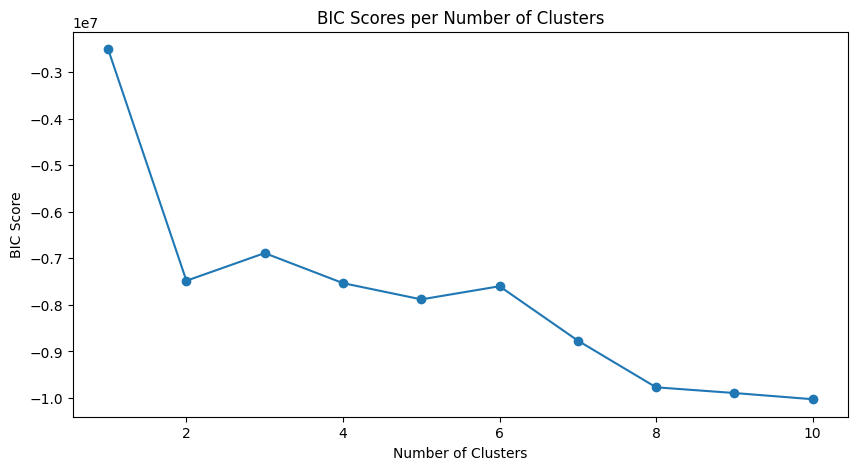

In [ ]:
features_for_gmm = final_df_for_clustering

# Find the best number of clusters using BIC
bic = []
n_components_range = range(1, 11)  # Modify this range if necessary
for n_components in n_components_range:
    gmm = GaussianMixture(n_components=n_components, random_state=42)
    gmm.fit(features_for_gmm)
    bic.append(gmm.bic(features_for_gmm))

# Plot BIC scores
plt.figure(figsize=(10, 5))
plt.plot(n_components_range, bic, marker='o')
plt.title('BIC Scores per Number of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('BIC Score')
plt.show()


*   Choose the number of clusters with the lowest BIC score
*   Fit the GMM with the best number of components found
*   Create a new DataFrame for GMM clustering results
*   Calculate silhouette score for GMM clustering





In [ ]:
# Choose the number of clusters with the lowest BIC score
best_n_components = n_components_range[np.argmin(bic)]
print(f'Optimal number of clusters: {best_n_components}')

# Fit the GMM with the best number of components found
gmm = GaussianMixture(n_components=best_n_components, random_state=42)
gmm.fit(features_for_gmm)
gmm_clusters = gmm.predict(features_for_gmm)

# Create a new DataFrame for GMM clustering results
gaussian_df = pd.DataFrame(features_for_gmm, columns=final_df_for_clustering.columns)
gaussian_df['GMM_clusters'] = gmm_clusters

# Calculate silhouette score for GMM clustering
sil_score = silhouette_score(features_for_gmm, gmm_clusters)
print(f'Silhouette Score: {sil_score}')


Optimal number of clusters: 10
Silhouette Score: 0.08135075685803729




*   Perform PCA for 2D visualization
*   Plot the PCA graph



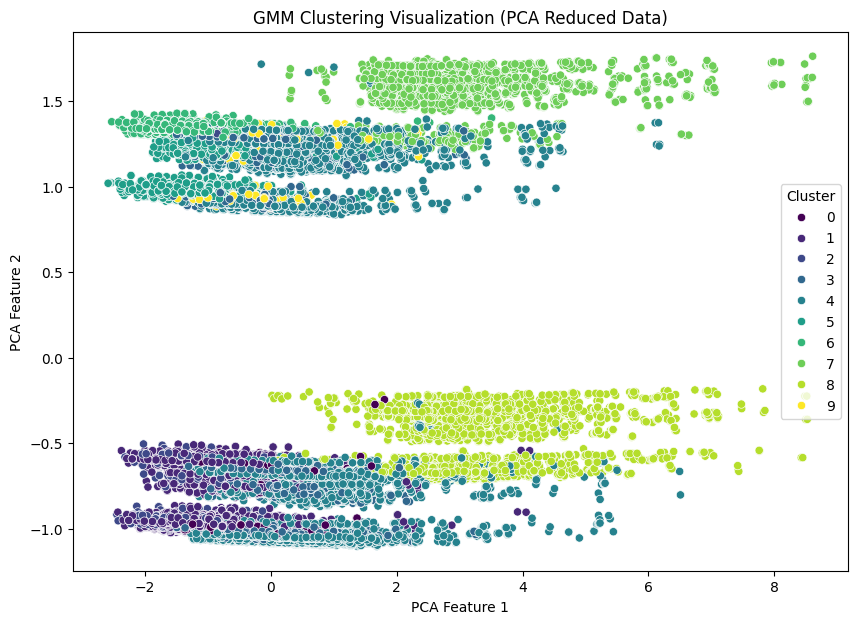

In [ ]:
# Perform PCA for 2D visualization
pca = PCA(n_components=2)
pca_result = pca.fit_transform(features_for_gmm)

# Visualize using PCA
plt.figure(figsize=(10, 7))
sns.scatterplot(x=pca_result[:, 0], y=pca_result[:, 1], hue=gmm_clusters, palette='viridis', legend='full')
plt.title('GMM Clustering Visualization (PCA Reduced Data)')
plt.xlabel('PCA Feature 1')
plt.ylabel('PCA Feature 2')
plt.legend(title='Cluster')
plt.show()





*   Perform t-SNE for 2D visualization
*   Plot the t-SNE graph



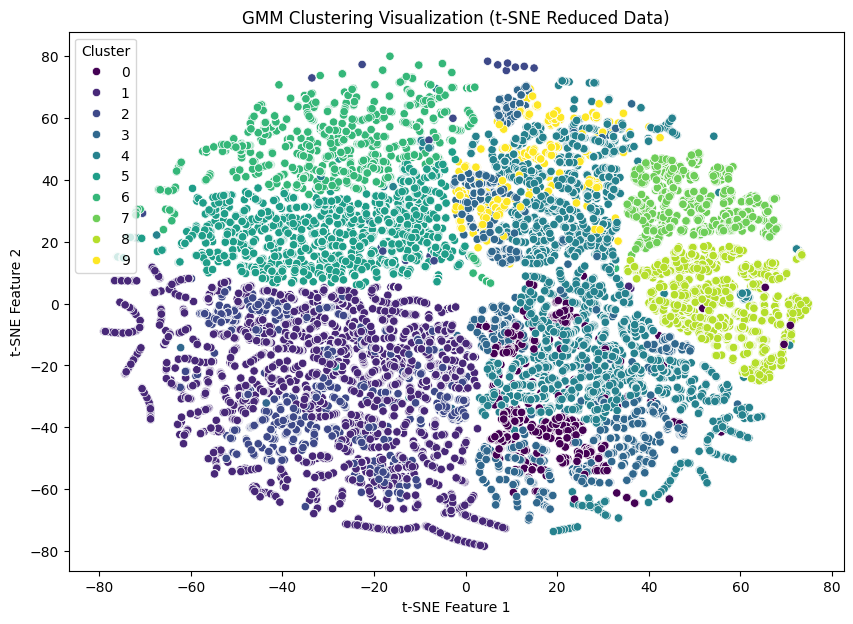

In [ ]:
# Perform t-SNE for 2D visualization
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42)
tsne_result = tsne.fit_transform(features_for_gmm)

# Visualize using t-SNE
plt.figure(figsize=(10, 7))
sns.scatterplot(x=tsne_result[:, 0], y=tsne_result[:, 1], hue=gmm_clusters, palette='viridis', legend='full')
plt.title('GMM Clustering Visualization (t-SNE Reduced Data)')
plt.xlabel('t-SNE Feature 1')
plt.ylabel('t-SNE Feature 2')
plt.legend(title='Cluster')
plt.show()

## 3. Hierarchical Clustering

Plot a Dendrogram for optimal number of clusters

In [ ]:
import numpy as np
import pandas as pd
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns

# Assume final_df_for_clustering is your preprocessed DataFrame

# Perform linkage
linked = linkage(final_df_for_clustering, method='ward')

# Create a dendrogram
dendro = dendrogram(linked)

# Set a threshold
distance_threshold = 150  # You might need to adjust this value

# Create a flat cluster assignment
from scipy.cluster.hierarchy import fcluster
clusters = fcluster(linked, distance_threshold, criterion='distance')

# Find the number of clusters
num_clusters = len(set(clusters))
print(f"Number of clusters formed below the distance threshold {distance_threshold}: {num_clusters}")


NameError: name 'plt' is not defined

In [ ]:
# Apply Agglomerative Clustering
hclust = AgglomerativeClustering(n_clusters=num_clusters, affinity='euclidean', linkage='ward')
cluster_labels = hclust.fit_predict(final_df_for_clustering)

# Evaluate the clustering performance using different metrics
silhouette_avg = silhouette_score(final_df_for_clustering, cluster_labels)
print(f'Silhouette Score: {silhouette_avg:.3f}')

db_index = davies_bouldin_score(final_df_for_clustering, cluster_labels)
print(f'Davies-Bouldin Index: {db_index:.3f}')

ch_index = calinski_harabasz_score(final_df_for_clustering, cluster_labels)
print(f'Calinski-Harabasz Index: {ch_index:.3f}')

# Visualization of clusters in 2D using PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(final_df_for_clustering)

plt.figure(figsize=(10, 7))
sns.scatterplot(x=pca_result[:, 0], y=pca_result[:, 1], hue=cluster_labels, palette='viridis', legend='full')
plt.title('Hierarchical Clustering Visualization (PCA Reduced Data)')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.legend()
plt.show()

## 4. OPTICS (Ordering Points To Identify the Clustering Structure) algorithm



*   Dimensionality reduction
*   Run OPTICS clustering
*   Evaluate with silhouette score (excluding noise)





In [ ]:
optics_data = final_df_for_clustering

# Dimensionality reduction
pca = PCA(n_components=2)  # Adjust if you want to keep more components
reduced_data = pca.fit_transform(optics_data)

# Run OPTICS clustering
optics_clust = OPTICS(min_samples=50, xi=0.05, min_cluster_size=0.05)
optics_clust.fit(reduced_data)

# Retrieve the labels
clusters = optics_clust.labels_

# Evaluate with silhouette score (excluding noise)
# Noise is labeled as -1, so we filter those out for evaluation
cleaned_labels = clusters[clusters != -1]
cleaned_data = reduced_data[clusters != -1]
if len(np.unique(cleaned_labels)) > 1:  # Silhouette score requires at least 2 clusters
    silhouette_avg = silhouette_score(cleaned_data, cleaned_labels)
    print(f'Silhouette Score (excluding noise): {silhouette_avg:.3f}')
else:
    print('Silhouette score cannot be computed for a single cluster.')


*   Plot the reachability distances
*   Visualization with PCA



In [ ]:
# Plot the reachability distances
plt.figure(figsize=(12, 7))
reachability = optics_clust.reachability_[optics_clust.ordering_]
plt.bar(range(len(reachability)), reachability, color='teal')
plt.title('Reachability plot')
plt.xlabel('Points')
plt.ylabel('Reachability Distance')
plt.show()

# Visualization with PCA
plt.figure(figsize=(12, 7))
sns.scatterplot(x=reduced_data[:, 0], y=reduced_data[:, 1], hue=clusters, palette='viridis', legend='full')
plt.title('OPTICS Clustering Visualization (PCA Reduced Data)')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.legend()
plt.show()


## 5.0 AffinityPropagation

In [46]:
import pandas as pd
from sklearn.cluster import AffinityPropagation

# Sample a subset of the data
ap_cluster_df = final_df_for_clustering.sample(frac=0.2, random_state=42)

# Initialize the Affinity Propagation model
# Damping factor between 0.5 and 1, preference can be adjusted based on the dataset characteristics
ap = AffinityPropagation(damping=0.9, preference=-50, random_state=42)

# Fit the model to your data
ap.fit(ap_cluster_df)

# Get the cluster labels
cluster_labels = ap.labels_

# Add cluster labels back to the original DataFrame for analysis
ap_cluster_df['cluster'] = cluster_labels

# Analyze the results
# Count the number of data points in each cluster
cluster_counts = ap_cluster_df['cluster'].value_counts()
print("Cluster counts:")
print(cluster_counts)

# Exemplars (cluster centers)
# Correctly access the attribute from the model instance `ap`
exemplars = ap.cluster_centers_indices_
print("Indices of exemplars (central points of clusters):", exemplars)

# Optional: Print the total number of clusters formed
print("Total number of clusters:", len(exemplars))


Cluster counts:
26    232
58    204
77    160
53    155
5     151
     ... 
98     29
73     27
62     25
99     23
6      12
Name: cluster, Length: 123, dtype: int64
Indices of exemplars (central points of clusters): [  25   52  112  200  274  327  341  351  590  681  717  761  838  849
  926 1005 1153 1475 1500 1548 1650 1672 1746 1768 1775 1785 1925 1984
 1985 2006 2057 2130 2173 2196 2263 2287 2423 2467 2640 2650 2701 2804
 2806 2848 3143 3165 3229 3347 3519 3551 3632 3673 3699 3723 3845 4122
 4203 4274 4371 4391 4426 4450 4527 4529 4622 4686 4766 4783 4785 4790
 4792 4805 4820 4932 4958 4961 5011 5143 5245 5253 5295 5370 5395 5532
 5586 5609 5750 5861 5946 6376 6462 6481 6516 6548 6552 6602 6738 6832
 7117 7207 7232 7310 7333 7337 7375 7397 7398 7601 7635 7718 7915 7920
 7921 7943 7951 7974 8081 8200 8370 8447 8530 8684 8714]
Total number of clusters: 123


In [47]:
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score

sil_score = silhouette_score(ap_cluster_df, ap.labels_)
print("Silhouette Score: ", sil_score)


ch_score = calinski_harabasz_score(ap_cluster_df, ap.labels_)
print("Calinski-Harabasz Index: ", ch_score)

db_score = davies_bouldin_score(ap_cluster_df, ap.labels_)
print("Davies-Bouldin Index: ", db_score)


Silhouette Score:  0.492822800515357
Calinski-Harabasz Index:  51048.8979199326
Davies-Bouldin Index:  0.8667300124705426


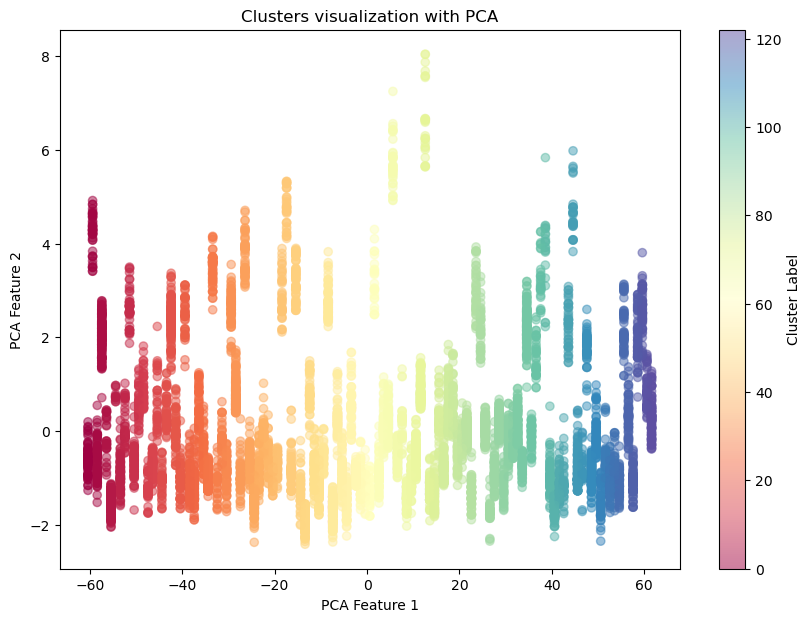

In [48]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Dimensionality reduction with PCA
pca = PCA(n_components=2)
reduced_data = pca.fit_transform(ap_cluster_df)

# Scatter plot of the two PCA dimensions
plt.figure(figsize=(10, 7))
plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=ap.labels_, cmap='Spectral', alpha=0.5)
plt.colorbar(label='Cluster Label')
plt.title('Clusters visualization with PCA')
plt.xlabel('PCA Feature 1')
plt.ylabel('PCA Feature 2')
plt.show()


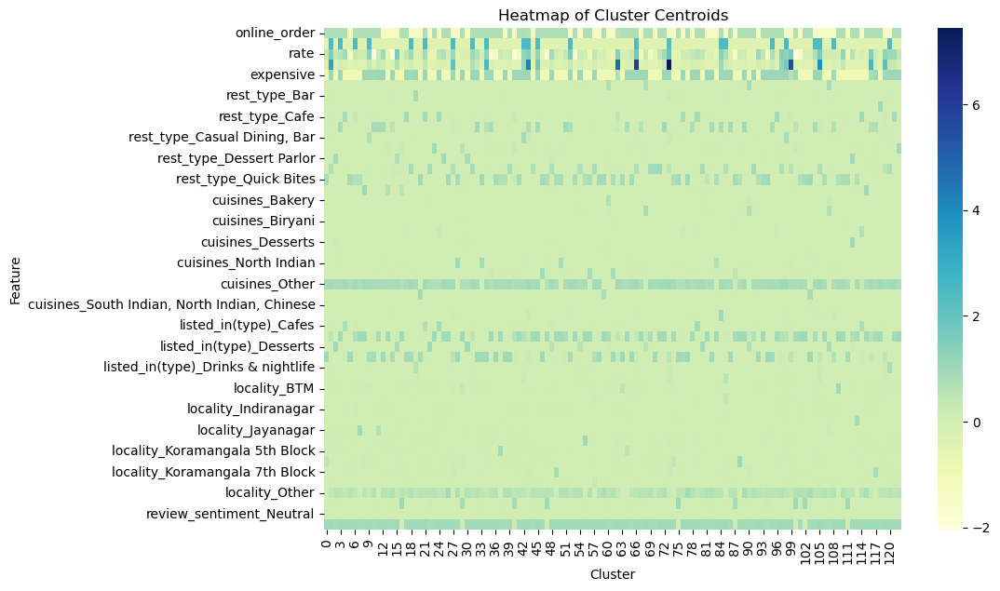

In [50]:
import seaborn as sns

# Calculate cluster centroids
centroids = ap_cluster_df.groupby('cluster').mean()

plt.figure(figsize=(10, 7))
sns.heatmap(centroids.T, cmap='YlGnBu')
plt.title('Heatmap of Cluster Centroids')
plt.xlabel('Cluster')
plt.ylabel('Feature')
plt.show()
